In [1]:
import pandas as pd
import numpy as np
import datetime
import re
import matplotlib.pyplot as plt
import glob
from scipy import stats
from dateutil import rrule, parser
import matplotlib.dates as mdates
import plotly.graph_objs as go
from plotly.offline import iplot, init_notebook_mode, plot
from plotly import tools
init_notebook_mode(connected=False)
pd.set_option('display.max_rows', False)
pd.set_option('display.max_columns', 100)

In [2]:
def load_and_clean_nancy(file_path, xlsx_sheet_number, time_column_name):
    
    #Chargement du fichier
    df_nancy = pd.read_excel(io=file_path, sheet_name=xlsx_sheet_number, header=1)
    #Suppression de la 1ere ligne inutile
    df_nancy = df_nancy[1:]
    #Definition de la colonne du timestamp
    df_nancy = df_nancy.rename(columns={df_nancy.columns[0]: time_column_name })
    #Definition du type des colonnes (sous forme de dict) + formatage de la colonne timestamp
    columns = list(df_nancy.columns)
    types_list = [datetime.datetime, np.float32, np.float32, np.float32]
    types_dict = dict(zip(columns,types_list))
    df_nancy = df_nancy.astype(types_dict)
    df_nancy[time_column_name]=pd.to_datetime(df_nancy[time_column_name], format="%Y-%m-%d %H:%M")
    
    return df_nancy

In [3]:
def check_na_values(df):
    bool_na_values = False
    #print(df[df.isna().any(axis=1)])
    for col in df:
        sum_nbr = df[col].isna().sum()
        if sum_nbr != 0:
            bool_na_values = True
        perc = round((sum_nbr/len(df))*100, 2)
        print(col, ":", str(sum_nbr),"(",perc,"%)")
    return bool_na_values

In [4]:
def interpolate_dataframe(df, method, axis, limit, limit_area, limit_direction="forward"):
    if (len(df._get_numeric_data().columns)) == len(df.columns):
        print("All columns are numeric")
        return df.interpolate(method=method, axis=axis, limit=limit, limit_area=limit_area, limit_direction=limit_direction)
    else:
        print("There are non-numeric columns")
        return_df = df.copy()
        numeric_cols = list(return_df._get_numeric_data().columns)
        return_df[numeric_cols] = return_df[numeric_cols].interpolate(method=method, axis=axis, limit=limit, limit_area=limit_area, limit_direction=limit_direction)
        return return_df

In [5]:
def working_day_process(df, date_col_name, weekday_col_name, working_day_col_name, hour_col_name, month_col_name, week_col_name, non_working_day_list):
    df_copy = df.copy()
    df_copy[weekday_col_name] = df_copy[date_col_name].dt.weekday
    df_copy["jour"] = df_copy[date_col_name].dt.day
    df_copy["minute"] = df_copy[date_col_name].dt.minute
    df_copy[working_day_col_name] = ~df_copy[weekday_col_name].isin(non_working_day_list)
    df_copy[hour_col_name] = df_copy[date_col_name].dt.hour
    df_copy[month_col_name] = df_copy[date_col_name].dt.month
    df_copy[week_col_name] = df_copy[date_col_name].dt.week
    df_copy["annee"] = df_copy[date_col_name].dt.year
    return df_copy

In [6]:
def load_and_clean_firefly(file_path, xlsx_sheet_number, time_column_name, emplacement):
    df_firefly = pd.read_excel(io=file_path, sheet_name=1, header=1)
    #Suppression des colonnes vides
    df_firefly = df_firefly.loc[:, ~df_firefly.columns.str.contains('^Unnamed')]
    #Suppression des retours a la ligne dans le nom des colonnes
    df_firefly.columns = [col.replace('\n', '') for col in df_firefly.columns]
    #Renommage de la colonne du timestamp
    df_firefly = df_firefly.rename(columns={df_firefly.columns[0]: time_column_name })
    #Imputation des valeurs manquantes
    print("Check NA values (",file_path,"):\n")
    if check_na_values(df_firefly) == True:
        df_firefly = interpolate_dataframe(df_firefly, "linear", 0, limit=1, limit_area=None)
    #Ajout des jours travailles
    df_firefly = working_day_process(df_firefly, time_column_name, "jour_semaine", "jour_travaille", "heure", "mois", "semaine", [6,7])
    #Ajout de la colonne emplacement
    df_firefly["emplacement"] = emplacement
    df_firefly = df_firefly.set_index("Date")
    
    
    
    return df_firefly

In [7]:
def process_sensor_type(file_path):
    df = pd.read_excel(io=file_path, sheet_name=0, header=4)
    emplacement = df.columns[0].split('\n')[1].split("Emplacement: ")[1]
    return emplacement

In [19]:
def load_clean_concatenate_firefly(parent_folder_path, key_name, xlsx_sheet_number, time_column_name):
    list_df = []
    for filename in glob.iglob(parent_folder_path + '*', recursive=True):
        
        if ((key_name in filename) & ('~' not in filename)):
            emplacement = process_sensor_type(filename)
            df = load_and_clean_firefly(filename, xlsx_sheet_number, time_column_name, emplacement)
            list_df.append(df)
            
    return pd.concat(list_df, ignore_index=False).sort_index("index")

In [12]:
def load_and_clean_ecosmart(file_path, xlsx_sheet_number, time_column_name):
    
    df_ecosmart = pd.read_excel(io=file_path, sheet_name=xlsx_sheet_number, header=4)
    columns_drop_list = ['Latitude', 'Longitude', "Altitude", "GPS Date", "Firmware Revision", "Communication"]
    columns_drop_list.append(df_ecosmart.columns[0])
    df_ecosmart = df_ecosmart.drop(columns_drop_list, axis=1)
    df_ecosmart = df_ecosmart.rename(columns={df_ecosmart.columns[0]: time_column_name })
    print("Check NA values (",file_path,"):\n")
    if check_na_values(df_ecosmart) == True:
        df_ecosmart = interpolate_dataframe(df_ecosmart, "linear", axis=0, limit=None, limit_area=None, limit_direction="both")
    df_ecosmart["cov(μg/m3)"] = (df_ecosmart["COV"]*56.106)/24.45
    df_ecosmart = working_day_process(df_ecosmart, time_column_name, "jour_semaine", "jour_travaille", "heure", "mois", "semaine", [6,7])
    df_ecosmart = df_ecosmart.set_index(time_column_name)
    
    return df_ecosmart

In [13]:
def load_clean_zaack(file_path, time_column_name):
    df_zaack = pd.read_csv(file_path, sep=";", header=0, infer_datetime_format=True, parse_dates=True).drop(["sensor_id"], axis=1)
    df_zaack = df_zaack.rename(columns={df_zaack.columns[-1]: time_column_name })
    df_zaack = df_zaack.replace(",", ".", regex=True)
    columns = list(df_zaack.columns)
    types_list = [np.float32, np.float32, np.float32, 
                  np.float32,np.float32,np.int,np.float32,np.float32, 
                  np.int, np.float32, np.float32, datetime.datetime]
    types_dict = dict(zip(columns,types_list))
    df_zaack = df_zaack.astype(types_dict)
    df_zaack["cov(μg/m3)"] = (df_zaack["cov"]*56.106*1000)/24.45
    df_zaack[time_column_name]=pd.to_datetime(df_zaack[time_column_name], format="%d/%m/%Y %H:%M:%S", exact=False)
    df_zaack = working_day_process(df_zaack, time_column_name, "jour_semaine", "jour_travaille", "heure", "mois", "semaine", [6,7])
    df_zaack["seconde"] = df_zaack[time_column_name].dt.second
    df_zaack = df_zaack.set_index(time_column_name)
    
    return df_zaack

In [18]:
df_nancy = load_and_clean_nancy("data/WK-ADM-COE-18-0723.xlsx", 1, "Date")
df_zaack_007 = load_clean_zaack("data/export_zaack_VINCI_28_aout_12_oct_2018_0007.csv", "Date")
df_zaack_328 = load_clean_zaack("data/export_zaack_VINCI_28_aout_12_oct_2018_0328.csv", "Date")
df_firefly = load_clean_concatenate_firefly("data/", "firefly", 1, "Date")
df_firefly_544 = df_firefly[df_firefly["emplacement"] == "GBOX000544"]
df_firefly_526 = df_firefly[df_firefly["emplacement"] == "GBOX000526"]
df_ecosmart = load_and_clean_ecosmart("data/ECS-N-GX-00067_20181011-120059_20181018-140059.xlsx", 0, "Date")

Check NA values ( data/Rapport sem 37 firefly 526 - Omega.xlsx ):

Date : 0 ( 0.0 %)
Temp.°C : 0 ( 0.0 %)
H.R.% : 0 ( 0.0 %)
BruitdB(A) : 0 ( 0.0 %)
CO2ppm : 0 ( 0.0 %)
COVLµg/m3 éq. Formaldéhyde : 0 ( 0.0 %)
COVGµg/m3 éq. Toluène : 0 ( 0.0 %)
Aérosols finsMpart/m3 : 0 ( 0.0 %)
Check NA values ( data/Rapport sem 33 firefly 544- Omega.xlsx ):

Date : 0 ( 0.0 %)
Temp.°C : 0 ( 0.0 %)
H.R.% : 0 ( 0.0 %)
BruitdB(A) : 0 ( 0.0 %)
CO2ppm : 0 ( 0.0 %)
COVLµg/m3 éq. Formaldéhyde : 0 ( 0.0 %)
COVGµg/m3 éq. Toluène : 0 ( 0.0 %)
Aérosols finsMpart/m3 : 0 ( 0.0 %)
Check NA values ( data/Rapport sem 33 firefly 526 - Omega.xlsx ):

Date : 0 ( 0.0 %)
Temp.°C : 0 ( 0.0 %)
H.R.% : 0 ( 0.0 %)
BruitdB(A) : 0 ( 0.0 %)
CO2ppm : 0 ( 0.0 %)
COVLµg/m3 éq. Formaldéhyde : 0 ( 0.0 %)
COVGµg/m3 éq. Toluène : 0 ( 0.0 %)
Aérosols finsMpart/m3 : 1 ( 0.13 %)
There are non-numeric columns
Check NA values ( data/Rapport sem 38 firefly 544- Omega.xlsx ):

Date : 0 ( 0.0 %)
Temp.°C : 0 ( 0.0 %)
H.R.% : 0 ( 0.0 %)
BruitdB(A

In [20]:
def comparison_firefly_zaack(df_firefly, indic_firefly, df_zaack, indic_zaack ,start, end, moyenne=False):
    df_f = df_firefly.loc[(df_firefly.index <= end) & (df_firefly.index >= start)]
    df_z = df_zaack.loc[(df_zaack.index <= end) & (df_zaack.index >= start)]

    df_f = df_f[[indic_firefly]]
    df_f = df_f.groupby(pd.Grouper(freq='10Min')).aggregate(np.mean)
    df_f[indic_firefly] = df_f[indic_firefly].replace({0:np.nan})
    
    if moyenne == True:
        df_f = df_f.groupby([df_f.index.hour, df_f.index.minute]).mean()
        df_f["hour"] = df_f.index.get_level_values(0)
        df_f["minute"] = df_f.index.get_level_values(1)
        df_f["month"] = 1
        df_f["year"] = 2018
        df_f["day"] = 1
        df_f["Date"] = pd.to_datetime(df_f[['year', 'month', 'day', 'hour', 'minute']])
        df_f['Date'] = [datetime.datetime.time(d) for d in df_f['Date']]
        df_f.index = df_f["Date"]
        df_f = df_f.drop(["hour", "minute", "month", "year", "day", "Date"], axis=1)
   
    df_z = df_z[[indic_zaack]]
    df_z = df_z.groupby(pd.Grouper(freq='10Min')).aggregate(np.mean)
    df_z[indic_zaack] = df_z[indic_zaack].replace({0:np.nan})
    
    if moyenne == True:
        df_z = df_z.groupby([df_z.index.hour, df_z.index.minute]).mean()
        df_z["hour"] = df_z.index.get_level_values(0)
        df_z["minute"] = df_z.index.get_level_values(1)
        df_z["month"] = 1
        df_z["year"] = 2018
        df_z["day"] = 1
        df_z["Date"] = pd.to_datetime(df_z[['year', 'month', 'day', 'hour', 'minute']])
        df_z['Date'] = [datetime.datetime.time(d) for d in df_z['Date']]
        df_z.index = df_z["Date"]
        df_z = df_z.drop(["hour", "minute", "month", "year", "day", "Date"], axis=1)
    
    df_merge = pd.merge(df_f, df_z, left_index=True, right_index=True, how="outer")
    
    return df_merge


In [21]:
def print_comparison_capteur(df_merge, indicateur_1, indicateur_2, title, sub_title1, sub_title2, xlabel, ylabel):
    ax = df_merge[[indicateur_1, indicateur_2]].plot(use_index=True, 
                                                               subplots=True,
                                                               title=title,
                                                               figsize=(18,13),
                                                            fontsize=20)

    ax[0].set_title(sub_title1)
    ax[0].set_ylabel(ylabel, fontsize=20)
    ax[0].set_xlabel(xlabel, fontsize=20)
    ax[0].title.set_size(20)
    ax[1].set_title(sub_title2)
    ax[1].set_ylabel(ylabel, fontsize=20)
    ax[1].set_xlabel(xlabel, fontsize=20)
    ax[1].title.set_size(20)
    
    # set monthly locator
    #ax[0].xaxis.set_major_locator(mdates.WeekdayLocator(byweekday=mdates.MO, interval=1))
    # set formatter
    #ax[0].xaxis.set_major_formatter(mdates.DateFormatter('%a-%d-%m'))
    # set font and rotation for date tick labels
    plt.gcf().autofmt_xdate()

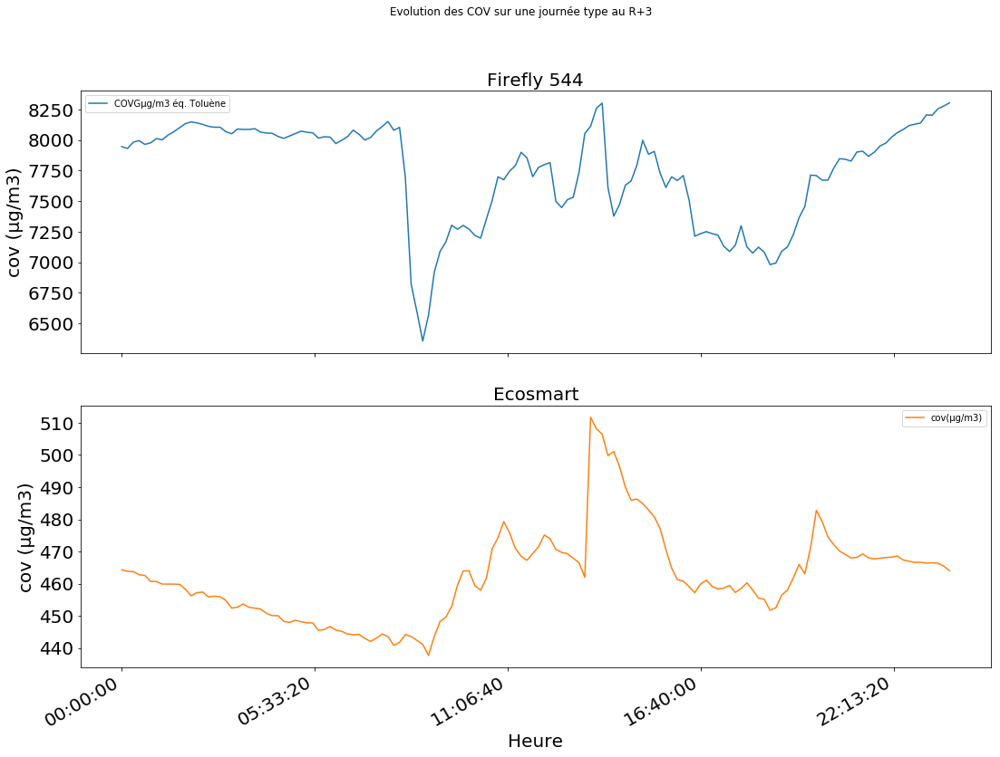

In [22]:
indicateur_1 = "COVGµg/m3 éq. Toluène"
indicateur_2 = "cov(μg/m3)"
start = "2018-10-04"
end = "2018-10-20"
title = "Evolution des COV sur une journée type au R+3"
sub_title1 = "Firefly 544"
sub_title2 = "Ecosmart"
ylabel = "cov (μg/m3)"
xlabel = "Heure"

df = comparison_firefly_zaack(df_firefly_544, indicateur_1, df_ecosmart,  indicateur_2, start, end, moyenne=True)
print_comparison_capteur(df, indicateur_1, indicateur_2, title, sub_title1, sub_title2, xlabel, ylabel)

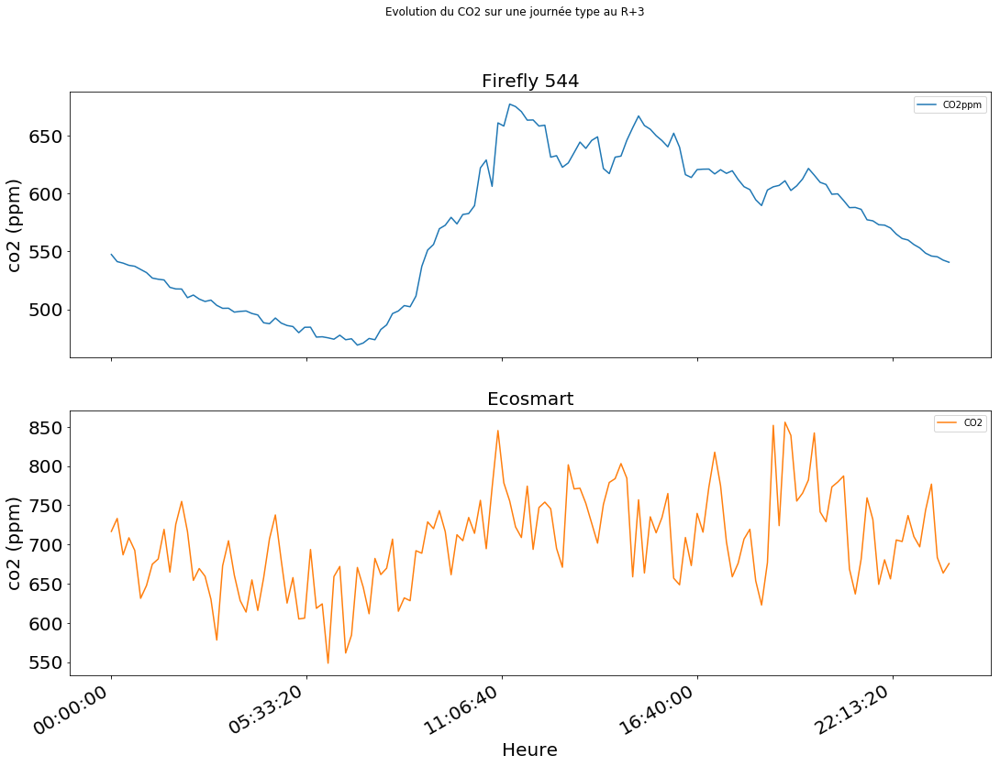

In [215]:
indicateur_1 = "CO2ppm"
indicateur_2 = "CO2"
start = "2018-10-04"
end = "2018-10-20"
title = "Evolution du CO2 sur une journée type au R+3"
sub_title1 = "Firefly 544"
sub_title2 = "Ecosmart"
ylabel = "co2 (ppm)"
xlabel = "Heure"

df = comparison_firefly_zaack(df_firefly_544, indicateur_1, df_ecosmart,  indicateur_2, start, end, moyenne=True)
print_comparison_capteur(df, indicateur_1, indicateur_2, title, sub_title1, sub_title2, xlabel, ylabel)

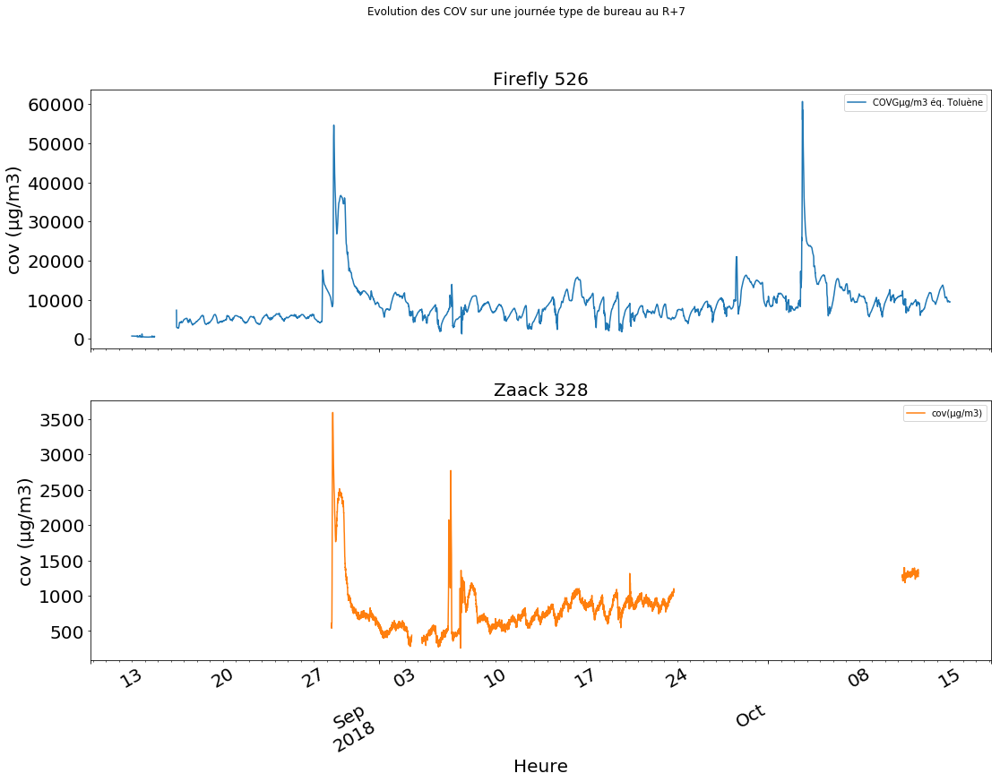

In [217]:
indicateur_1 = "COVGµg/m3 éq. Toluène"
indicateur_2 = "cov(μg/m3)"
start = "2018-08-13"
end = "2018-10-20"
title = "Evolution des COV sur une journée type de bureau au R+7"
sub_title1 = "Firefly 526"
sub_title2 = "Zaack 328"
ylabel = "cov (μg/m3)"
xlabel = "Heure"

df = comparison_firefly_zaack(df_firefly_526, indicateur_1, df_zaack_328,  indicateur_2, start, end, moyenne=False)
print_comparison_capteur(df, indicateur_1, indicateur_2, title, sub_title1, sub_title2, xlabel, ylabel)

In [23]:
def print_simulation(tab_df_simulation, Di_to_print):
    """
    :param tab_df_simulation: Output de la simulation
    :param Di_to_print: Tableau des diamètres à afficher
    """
    
    courbes=[]
    for i in Di_to_print:
        df_simulation = tab_df_simulation[i-1]
        trace0 = go.Scatter(x=df_simulation.index, y=df_simulation['delta(t)'], name='D'+str(i+1))
        trace1 = go.Scatter(x=df_simulation.index, y=df_simulation['Di_noisy'], name='D'+str(i+1) + ' bruit total', mode='lines+markers')
        trace2 = go.Scatter(x=df_simulation.index, y=df_simulation['erreur_horizontale']+df_simulation['delta(t)'], name='erreur horizontale', mode='lines+markers')
        trace3 = go.Scatter(x=df_simulation.index, y=df_simulation['erreur_rc']+df_simulation['delta(t)'], name='erreur rc', mode='lines+markers')
        trace4 = go.Scatter(x=df_simulation.index, y=df_simulation['erreur_vert']+df_simulation['delta(t)'], name='erreur verticale', mode='lines+markers')
        trace5 = go.Scatter(x=df_simulation.index, y=df_simulation['erreur_loi_capteur']+df_simulation['delta(t)'], name='erreur loi capteur', mode='lines+markers')
        courbes.append(trace0)
        courbes.append(trace1)
        courbes.append(trace2)
        courbes.append(trace3)
        courbes.append(trace4)
        courbes.append(trace5)
    layout= go.Layout(title='Evolution des mesures de diamètres avec et sans bruit')

    fig=go.Figure(data=courbes, layout=layout)
    fig['layout'].update(height=800, width=1000)
    iplot(fig)
    
    """
    layout.title = "Di(t)-Di(t-1)"
    trace = go.Scatter(x=df_simulation.index, y=tab_df_simulation[0]['Ecart_Di'])
    fig1=go.Figure(data=[trace], layout=layout)
    iplot(fig1)
    
    layout.title = "epsilon(t)-epsilon(t-1)"
    trace = go.Scatter(x=df_simulation.index, y=tab_df_simulation[0]['erreur_totale'])
    fig2=go.Figure(data=[trace], layout=layout)
    iplot(fig2)
    """

,COVGµg/m3 éq. Toluène,cov(μg/m3)
Date,,
00:00:00,7945.727273,464.320391
00:10:00,7930.454545,463.835978
00:20:00,7982.000000,463.739072
00:30:00,7995.000000,462.767981
00:40:00,7963.909091,462.545535
00:50:00,7976.636364,460.663206
01:00:00,8011.727273,460.651943
01:10:00,8001.454545,459.865691
01:20:00,8039.818182,459.862577


In [27]:
df_ecosmart

,Temp,RH,Pressure,CO,NO2,O3,COV,CO2,PM 1,PM 2.5,PM 10,cov(μg/m3),jour_semaine,jour,minute,jour_travaille,heure,mois,semaine,annee
Date,,,,,,,,,,,,,,,,,,,,
2018-10-11 13:36:23,19.725,52.182,974.654,0.000,18.3740,0.000,395.437,726.985,12.947,17.629,67.877,907.418745,3,11,36,True,13,10,41,2018
2018-10-11 13:37:24,19.897,51.888,974.658,0.000,18.3740,0.000,385.137,726.985,13.431,17.205,47.566,883.783089,3,11,37,True,13,10,41,2018
2018-10-11 13:38:24,20.047,51.559,974.676,0.000,18.3740,0.000,385.137,726.985,13.189,17.417,57.722,883.783089,3,11,38,True,13,10,41,2018
2018-10-11 13:39:23,20.219,51.196,974.676,0.000,16.9475,0.000,374.838,729.809,13.203,16.651,35.479,860.149727,3,11,39,True,13,10,41,2018
2018-10-11 13:40:24,20.358,50.896,974.677,0.000,15.5210,0.000,381.017,732.633,13.051,17.044,48.685,874.328826,3,11,40,True,13,10,41,2018
2018-10-11 13:41:23,20.433,50.724,974.632,0.000,13.8000,0.000,378.271,733.768,13.074,17.022,44.332,868.027514,3,11,41,True,13,10,41,2018
2018-10-11 13:42:24,20.519,50.562,974.623,0.000,12.6610,0.000,376.309,740.657,12.932,16.897,45.606,863.525266,3,11,42,True,13,10,41,2018
2018-10-11 13:43:24,20.658,50.354,974.630,0.000,12.6990,0.000,374.838,742.233,12.921,16.842,44.220,860.149727,3,11,43,True,13,10,41,2018
2018-10-11 13:44:24,20.766,50.187,974.617,0.000,12.6990,0.000,374.838,742.233,12.921,16.842,44.220,860.149727,3,11,44,True,13,10,41,2018


In [34]:
trace0 = go.Scatter(x=df_ecosmart.index, y=df_ecosmart['COV'], name='Ecosmart')
layout= go.Layout(title='Evolution des mesures de COV dans le temps')
fig=go.Figure(data=[trace0], layout=layout)
fig['layout'].update(height=800, width=1000)
iplot(fig)

In [38]:
trace1 = go.Scatter(x=df.index, y=df['COVGµg/m3 éq. Toluène'], name='Firefly 544')
layout= go.Layout(title='Evolution des mesures de COV dans le temps')
fig=go.Figure(data=[trace1], layout=layout)
fig['layout'].update(height=800, width=1000)
iplot(fig)

In [ ]:
def comparison_firefly_zaack(df_firefly, indic_firefly, df_zaack, indic_zaack ,start, end, moyenne=False):
    df_f = df_firefly.loc[(df_firefly.index <= end) & (df_firefly.index >= start)]
    df_z = df_zaack.loc[(df_zaack.index <= end) & (df_zaack.index >= start)]

    df_f = df_f[[indic_firefly]]
    df_f = df_f.groupby(pd.Grouper(freq='10Min')).aggregate(np.mean)
    df_f[indic_firefly] = df_f[indic_firefly].replace({0:np.nan})
    
    if moyenne == True:
        df_f = df_f.groupby([df_f.index.hour, df_f.index.minute]).mean()
        df_f["hour"] = df_f.index.get_level_values(0)
        df_f["minute"] = df_f.index.get_level_values(1)
        df_f["month"] = 1
        df_f["year"] = 2018
        df_f["day"] = 1
        df_f["Date"] = pd.to_datetime(df_f[['year', 'month', 'day', 'hour', 'minute']])
        df_f['Date'] = [datetime.datetime.time(d) for d in df_f['Date']]
        df_f.index = df_f["Date"]
        df_f = df_f.drop(["hour", "minute", "month", "year", "day", "Date"], axis=1)
   
    df_z = df_z[[indic_zaack]]
    df_z = df_z.groupby(pd.Grouper(freq='10Min')).aggregate(np.mean)
    df_z[indic_zaack] = df_z[indic_zaack].replace({0:np.nan})
    
    if moyenne == True:
        df_z = df_z.groupby([df_z.index.hour, df_z.index.minute]).mean()
        df_z["hour"] = df_z.index.get_level_values(0)
        df_z["minute"] = df_z.index.get_level_values(1)
        df_z["month"] = 1
        df_z["year"] = 2018
        df_z["day"] = 1
        df_z["Date"] = pd.to_datetime(df_z[['year', 'month', 'day', 'hour', 'minute']])
        df_z['Date'] = [datetime.datetime.time(d) for d in df_z['Date']]
        df_z.index = df_z["Date"]
        df_z = df_z.drop(["hour", "minute", "month", "year", "day", "Date"], axis=1)
    
    df_merge = pd.merge(df_f, df_z, left_index=True, right_index=True, how="outer")
    
    return df_merge


In [132]:
a = resolve_dataframes_for_printing([(df_firefly_526, ["COVGµg/m3 éq. Toluène", "H.R.%"], "Firefly 526"), 
                                    (df_zaack_328, ["cov(μg/m3)", "humidity"], "Zaack 328")],
                                   list_dates=[], 
                                   moyenne=True, 
                                   replace_zero=True)

In [133]:
list1, list2, list3 = zip(*a)

In [143]:
list2

(['COVGµg/m3 éq. Toluène', 'H.R.%'], ['cov(μg/m3)', 'humidity'])

In [225]:
def resolve_dataframes_for_printing(list_tuples, list_dates, moyenne=False, replace_zero=False):
    new_tup_list = []
    for tup in list_tuples:
        tmp = tup[0]
        for idx, date in enumerate(list_dates):
            #Start
            if idx%2 == 0:
                tmp = tmp.loc[(tmp.index >= date)]
            #End
            else:
                tmp = tmp.loc[(tmp.index <= date)]
        tmp = tmp[tup[1]]
        if replace_zero == True:
            dict_replace = (dict(((s,{0: np.nan}) for s in tup[1])))
            tmp = tmp.replace(dict_replace)

        if moyenne == True:
            tmp = tmp.groupby([tmp.index.hour, tmp.index.minute]).mean()
            tmp["hour"] = tmp.index.get_level_values(0)
            tmp["minute"] = tmp.index.get_level_values(1)
            tmp["month"] = 1
            tmp["year"] = 2018
            tmp["day"] = 1
            tmp["Date"] = pd.to_datetime(tmp[['year', 'month', 'day', 'hour', 'minute']])
            tmp['Date'] = [datetime.datetime.time(d) for d in tmp['Date']]
            tmp.index = tmp["Date"]
            tmp = tmp.drop(["hour", "minute", "month", "year", "day", "Date"], axis=1)
        new_tup_list.append((tmp, tup[1], tup[2]))
    return new_tup_list

In [235]:
def afficher_graphes(liste_tuples, 
                     liste_dates,
                     title,
                     moyenne=False, 
                     remplacer_zero=False, 
                     afficher_capteur_verticalement=True,
                     mode="lines"):

    tuples_to_print = resolve_dataframes_for_printing(liste_tuples, liste_dates, moyenne=moyenne, replace_zero=remplacer_zero)
    list_df, columns, names = zip(*tuples_to_print)
    courbes=[]
    
    max_columns=0
    for j in columns:
        if len(j)> max_columns:
            max_columns=len(j)
    
    if afficher_capteur_verticalement == True:
        fig = tools.make_subplots(rows=max_columns, cols=len(list_df))
    else:
        fig = tools.make_subplots(rows=len(list_df), cols=max_columns)
        
    for idx, capteur in enumerate(list_df):
        for idx_column, column in enumerate(columns[idx]):
            name=column+' ('+names[idx]+')'
            trace = go.Scatter(x=capteur.index, y=capteur[column], name=name, connectgaps=False, mode=mode)
            if afficher_capteur_verticalement == True:
                x=idx_column+1
                y=idx+1
                position_axe = len(list_df)*(idx_column)+(idx+1)
            else:
                x=idx+1
                y=idx_column+1
                position_axe = idx*max_columns+(idx_column+1)
            fig.append_trace(trace, x, y)
            
            fig['layout']['xaxis'+str(position_axe)].update(title='Temps')
            fig['layout']['yaxis'+str(position_axe)].update(title=column)
            if moyenne == True:
                fig['layout']['xaxis'+str(position_axe)].update(tickangle=52)
    
    fig["layout"].update(title=title)
    fig['layout'].update(height=800, width=1000)
    iplot(fig) 

In [245]:
afficher_graphes(liste_tuples=[(df_firefly_526, ["COVGµg/m3 éq. Toluène", "H.R.%"], "Firefly 526"), 
                                    (df_zaack_328, ["cov(μg/m3)", "humidity"], "Zaack 328")], 
                 liste_dates=["2018-09-01", "2018-09-30"],
                 title="Evolution des taux de COV et d'humidité",
                 moyenne=False, 
                 remplacer_zero=True, 
                 afficher_capteur_verticalement=False)

This is the format of your plot grid:
[ (1,1) x1,y1 ]  [ (1,2) x2,y2 ]
[ (2,1) x3,y3 ]  [ (2,2) x4,y4 ]

